# データ取得

In [15]:
import os
import earthaccess
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import xarray as xr
import sys
from dotenv import load_dotenv
sys.path.append('../modules/')
from emit_tools import emit_xarray

In [2]:
# Authentication
load_dotenv()
earthaccess.login(strategy="environment", persist=True)

Skipping field DAAC Scene Numbers: unsupported OGR type: 5
Skipping field Scene FIDs: unsupported OGR type: 5
Skipping field DAAC Scene Names: unsupported OGR type: 5
/Users/ishidaryoma/miniforge3/envs/lpdaac_vitals/lib/python3.10/site-packages/pyogrio/geopandas.py:49: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  res = pd.to_datetime(ser, **datetime_kwargs)
/Users/ishidaryoma/miniforge3/envs/lpdaac_vitals/lib/python3.10/site-packages/pyogrio/geopandas.py:49: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  res = pd.to_datetime(ser, **datetime_kwargs)


0    POLYGON ((-84.34997 34.32245, -84.35973 34.321...
Name: geometry, dtype: geometry


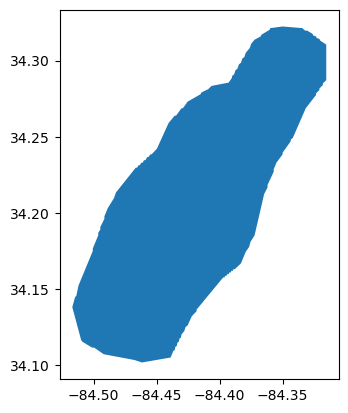

In [4]:
# geojsonを読み込み
geojson = gpd.read_file("../../data/methane_plume/EMIT_L2B_CH4PLM_001_20241020T170504_003677.json")
print(geojson.geometry)
geojson.plot()
plt.show()

In [5]:
# バウンディングボックスを取得
bbox = tuple(list(geojson.total_bounds))
print("Bounding Box: ", bbox)

Bounding Box:  (-84.5169747, 34.1017639, -84.3152642, 34.3224525)


In [6]:
# ポリゴンを取得
polygon = list(geojson.geometry[0].exterior.coords)
print("Polygon: ", polygon)

Polygon:  [(-84.3499671, 34.3224525), (-84.3597272, 34.3213681), (-84.3602695, 34.3202836), (-84.3667763, 34.3170302), (-84.3673185, 34.3159458), (-84.3721986, 34.3137768), (-84.3749097, 34.3110657), (-84.3759942, 34.3083545), (-84.3792476, 34.3051011), (-84.3803321, 34.3023899), (-84.3819588, 34.3013055), (-84.3830432, 34.2985943), (-84.3846699, 34.2975098), (-84.3857544, 34.2947987), (-84.3873811, 34.2937142), (-84.3884656, 34.2910031), (-84.3900923, 34.2899186), (-84.3900923, 34.2888341), (-84.3928034, 34.2855807), (-84.4063592, 34.2834118), (-84.4090704, 34.2812429), (-84.4144927, 34.2790739), (-84.415035, 34.2779895), (-84.4253374, 34.2731094), (-84.429133, 34.2687715), (-84.4302175, 34.2687715), (-84.4345553, 34.2638914), (-84.4356398, 34.2638914), (-84.4405199, 34.2590113), (-84.4497378, 34.2422021), (-84.4540757, 34.2384065), (-84.4551602, 34.2384065), (-84.4562446, 34.2367798), (-84.4573291, 34.2367798), (-84.4589558, 34.2346109), (-84.4600403, 34.2346109), (-84.4611247, 34.23

In [7]:
# 検索パラメータを設定
start_date = "2024-10-20"
end_date = "2024-10-21"
bbox = tuple(list(geojson.total_bounds))

In [8]:
l2a_results = earthaccess.search_data(
    short_name="EMITL2ARFL",
    bounding_box=bbox,
    temporal=(start_date, end_date)
)
l2b_results = earthaccess.search_data(
    short_name="EMITL2BCH4PLM",
    bounding_box=bbox,
    temporal=(start_date, end_date)
)

In [9]:
# 検索結果を表示
print("L2A Results: ", l2a_results)
print("L2B Results: ", l2b_results)

L2A Results:  [Collection: {'ShortName': 'EMITL2ARFL', 'Version': '001'}
Spatial coverage: {'HorizontalSpatialDomain': {'Geometry': {'GPolygons': [{'Boundary': {'Points': [{'Longitude': -84.61880493164062, 'Latitude': 34.750511169433594}, {'Longitude': -85.1097412109375, 'Latitude': 34.136802673339844}, {'Longitude': -84.42344665527344, 'Latitude': 33.587799072265625}, {'Longitude': -83.93251037597656, 'Latitude': 34.201507568359375}, {'Longitude': -84.61880493164062, 'Latitude': 34.750511169433594}]}}]}}}
Temporal coverage: {'RangeDateTime': {'BeginningDateTime': '2024-10-20T17:05:04Z', 'EndingDateTime': '2024-10-20T17:05:16Z'}}
Size(MB): 3579.867856025696
Data: ['https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/EMITL2ARFL.001/EMIT_L2A_RFL_001_20241020T170504_2429411_003/EMIT_L2A_RFL_001_20241020T170504_2429411_003.nc', 'https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/EMITL2ARFL.001/EMIT_L2A_RFL_001_20241020T170504_2429411_003/EMIT_L2A_RFLUNCERT_001_20241020

In [10]:
df_l2a = pd.json_normalize(l2b_results)
df_l2b = pd.json_normalize(l2b_results)
print(df_l2a.columns)

Index(['size', 'meta.concept-type', 'meta.concept-id', 'meta.revision-id',
       'meta.native-id', 'meta.collection-concept-id', 'meta.provider-id',
       'meta.format', 'meta.revision-date',
       'umm.TemporalExtent.SingleDateTime', 'umm.GranuleUR',
       'umm.AdditionalAttributes',
       'umm.SpatialExtent.HorizontalSpatialDomain.Geometry.GPolygons',
       'umm.ProviderDates', 'umm.CollectionReference.ShortName',
       'umm.CollectionReference.Version', 'umm.PGEVersionClass.PGEName',
       'umm.PGEVersionClass.PGEVersion', 'umm.RelatedUrls', 'umm.CloudCover',
       'umm.DataGranule.DayNightFlag',
       'umm.DataGranule.ArchiveAndDistributionInformation',
       'umm.DataGranule.ProductionDateTime', 'umm.Platforms',
       'umm.MetadataSpecification.URL', 'umm.MetadataSpecification.Name',
       'umm.MetadataSpecification.Version'],
      dtype='object')


In [11]:
print(df_l2a["umm.SpatialExtent.HorizontalSpatialDomain.Geometry.GPolygons"])

0    [{'Boundary': {'Points': [{'Longitude': -84.34...
Name: umm.SpatialExtent.HorizontalSpatialDomain.Geometry.GPolygons, dtype: object


In [12]:
spacial_extent = df_l2a["umm.SpatialExtent.HorizontalSpatialDomain.Geometry.GPolygons"][0]
points = spacial_extent[0]["Boundary"]["Points"]
print(points)

[{'Longitude': -84.3499671, 'Latitude': 34.3224525}, {'Longitude': -84.3597272, 'Latitude': 34.3213681}, {'Longitude': -84.3602695, 'Latitude': 34.3202836}, {'Longitude': -84.3667763, 'Latitude': 34.3170302}, {'Longitude': -84.3673185, 'Latitude': 34.3159458}, {'Longitude': -84.3721986, 'Latitude': 34.3137768}, {'Longitude': -84.3749097, 'Latitude': 34.3110657}, {'Longitude': -84.3759942, 'Latitude': 34.3083545}, {'Longitude': -84.3792476, 'Latitude': 34.3051011}, {'Longitude': -84.3803321, 'Latitude': 34.3023899}, {'Longitude': -84.3819588, 'Latitude': 34.3013055}, {'Longitude': -84.3830432, 'Latitude': 34.2985943}, {'Longitude': -84.3846699, 'Latitude': 34.2975098}, {'Longitude': -84.3857544, 'Latitude': 34.2947987}, {'Longitude': -84.3873811, 'Latitude': 34.2937142}, {'Longitude': -84.3884656, 'Latitude': 34.2910031}, {'Longitude': -84.3900923, 'Latitude': 34.2899186}, {'Longitude': -84.3900923, 'Latitude': 34.2888341}, {'Longitude': -84.3928034, 'Latitude': 34.2855807}, {'Longitude

In [13]:
min_lat = float("inf")
max_lat = float("-inf")
min_lon = float("inf")
max_lon = float("-inf")

for point in points:
    lat = float(point["Latitude"])
    lon = float(point["Longitude"])
    min_lat = min(min_lat, lat)
    max_lat = max(max_lat, lat)
    min_lon = min(min_lon, lon)
    max_lon = max(max_lon, lon)

l2a_bbox = (min_lon, min_lat, max_lon, max_lat)
print("L2A Bounding Box: ", l2a_bbox)

L2A Bounding Box:  (-84.5169747, 34.1017639, -84.3152642, 34.3224525)


In [14]:
l2a_results[0]

Collection: {'ShortName': 'EMITL2ARFL', 'Version': '001'}
Spatial coverage: {'HorizontalSpatialDomain': {'Geometry': {'GPolygons': [{'Boundary': {'Points': [{'Longitude': -84.61880493164062, 'Latitude': 34.750511169433594}, {'Longitude': -85.1097412109375, 'Latitude': 34.136802673339844}, {'Longitude': -84.42344665527344, 'Latitude': 33.587799072265625}, {'Longitude': -83.93251037597656, 'Latitude': 34.201507568359375}, {'Longitude': -84.61880493164062, 'Latitude': 34.750511169433594}]}}]}}}
Temporal coverage: {'RangeDateTime': {'BeginningDateTime': '2024-10-20T17:05:04Z', 'EndingDateTime': '2024-10-20T17:05:16Z'}}
Size(MB): 3579.867856025696
Data: ['https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/EMITL2ARFL.001/EMIT_L2A_RFL_001_20241020T170504_2429411_003/EMIT_L2A_RFL_001_20241020T170504_2429411_003.nc', 'https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/EMITL2ARFL.001/EMIT_L2A_RFL_001_20241020T170504_2429411_003/EMIT_L2A_RFLUNCERT_001_20241020T170504_2429411_003.nc', 'https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/EMITL2ARFL.001/EMIT_L2A_RFL_001_20241020T170504_2429411_003/EMIT_L2A_MASK_001_20241020T170504_2429411_003.nc']

In [15]:
print(type(l2a_results[0]))

<class 'earthaccess.results.DataGranule'>


In [16]:
l2b_results[0]

Collection: {'ShortName': 'EMITL2BCH4PLM', 'Version': '001'}
Spatial coverage: {'HorizontalSpatialDomain': {'Geometry': {'GPolygons': [{'Boundary': {'Points': [{'Longitude': -84.3499671, 'Latitude': 34.3224525}, {'Longitude': -84.3597272, 'Latitude': 34.3213681}, {'Longitude': -84.3602695, 'Latitude': 34.3202836}, {'Longitude': -84.3667763, 'Latitude': 34.3170302}, {'Longitude': -84.3673185, 'Latitude': 34.3159458}, {'Longitude': -84.3721986, 'Latitude': 34.3137768}, {'Longitude': -84.3749097, 'Latitude': 34.3110657}, {'Longitude': -84.3759942, 'Latitude': 34.3083545}, {'Longitude': -84.3792476, 'Latitude': 34.3051011}, {'Longitude': -84.3803321, 'Latitude': 34.3023899}, {'Longitude': -84.3819588, 'Latitude': 34.3013055}, {'Longitude': -84.3830432, 'Latitude': 34.2985943}, {'Longitude': -84.3846699, 'Latitude': 34.2975098}, {'Longitude': -84.3857544, 'Latitude': 34.2947987}, {'Longitude': -84.3873811, 'Latitude': 34.2937142}, {'Longitude': -84.3884656, 'Latitude': 34.2910031}, {'Longitude': -84.3900923, 'Latitude': 34.2899186}, {'Longitude': -84.3900923, 'Latitude': 34.2888341}, {'Longitude': -84.3928034, 'Latitude': 34.2855807}, {'Longitude': -84.4063592, 'Latitude': 34.2834118}, {'Longitude': -84.4090704, 'Latitude': 34.2812429}, {'Longitude': -84.4144927, 'Latitude': 34.2790739}, {'Longitude': -84.415035, 'Latitude': 34.2779895}, {'Longitude': -84.4253374, 'Latitude': 34.2731094}, {'Longitude': -84.429133, 'Latitude': 34.2687715}, {'Longitude': -84.4302175, 'Latitude': 34.2687715}, {'Longitude': -84.4345553, 'Latitude': 34.2638914}, {'Longitude': -84.4356398, 'Latitude': 34.2638914}, {'Longitude': -84.4405199, 'Latitude': 34.2590113}, {'Longitude': -84.4497378, 'Latitude': 34.2422021}, {'Longitude': -84.4540757, 'Latitude': 34.2384065}, {'Longitude': -84.4551602, 'Latitude': 34.2384065}, {'Longitude': -84.4562446, 'Latitude': 34.2367798}, {'Longitude': -84.4573291, 'Latitude': 34.2367798}, {'Longitude': -84.4589558, 'Latitude': 34.2346109}, {'Longitude': -84.4600403, 'Latitude': 34.2346109}, {'Longitude': -84.4611247, 'Latitude': 34.2329842}, {'Longitude': -84.4622092, 'Latitude': 34.2329842}, {'Longitude': -84.4632937, 'Latitude': 34.2313575}, {'Longitude': -84.4643781, 'Latitude': 34.2313575}, {'Longitude': -84.4654626, 'Latitude': 34.2297308}, {'Longitude': -84.466547, 'Latitude': 34.2297308}, {'Longitude': -84.4822718, 'Latitude': 34.2134638}, {'Longitude': -84.4838985, 'Latitude': 34.2096682}, {'Longitude': -84.4887786, 'Latitude': 34.2031614}, {'Longitude': -84.4914897, 'Latitude': 34.1977391}, {'Longitude': -84.4914897, 'Latitude': 34.1961124}, {'Longitude': -84.4947431, 'Latitude': 34.19069}, {'Longitude': -84.4947431, 'Latitude': 34.1890633}, {'Longitude': -84.4963698, 'Latitude': 34.1868944}, {'Longitude': -84.4963698, 'Latitude': 34.1852677}, {'Longitude': -84.5007077, 'Latitude': 34.176592}, {'Longitude': -84.5007077, 'Latitude': 34.1749653}, {'Longitude': -84.5120946, 'Latitude': 34.1521915}, {'Longitude': -84.5137213, 'Latitude': 34.1456847}, {'Longitude': -84.5148057, 'Latitude': 34.1446003}, {'Longitude': -84.5169747, 'Latitude': 34.1380935}, {'Longitude': -84.5099256, 'Latitude': 34.1164042}, {'Longitude': -84.5088412, 'Latitude': 34.1153197}, {'Longitude': -84.5012499, 'Latitude': 34.1115241}, {'Longitude': -84.4996232, 'Latitude': 34.1115241}, {'Longitude': -84.492032, 'Latitude': 34.1071862}, {'Longitude': -84.4676315, 'Latitude': 34.1033906}, {'Longitude': -84.461667, 'Latitude': 34.1017639}, {'Longitude': -84.4388932, 'Latitude': 34.1050173}, {'Longitude': -84.4367243, 'Latitude': 34.1093552}, {'Longitude': -84.4356398, 'Latitude': 34.1098974}, {'Longitude': -84.4350976, 'Latitude': 34.1120663}, {'Longitude': -84.4340131, 'Latitude': 34.1126086}, {'Longitude': -84.4334709, 'Latitude': 34.1147775}, {'Longitude': -84.4323864, 'Latitude': 34.1153197}, {'Longitude': -84.4318442, 'Latitude': 34.1174887}, {'Longitude': -84.4307597, 'Latitude': 34.1180309}, {'Longitude': -84.4302175, 'Latitude': 34.1201998}, 

In [21]:
# stream data
output_path = "../../data/methane_plume"

l2a_urls = [granule.data_links() for granule in l2a_results][0]
l2b_urls = [granule.data_links() for granule in l2b_results][0]

In [ ]:
# download data
l2a_files = earthaccess.download(l2a_results, output_path)
print(l2a_files)

QUEUEING TASKS | :   0%|          | 0/3 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/3 [00:00<?, ?it/s]

In [24]:
def download_from_url(urls, output_path):
    fs = earthaccess.get_requests_https_session()
    for url in urls:
        granule_asset_id = url.split("/")[-1]
        fp = f"{output_path}/{granule_asset_id}"
        if not os.path.exists(fp):
            with fs.get(url, stream=True) as src:
                with open(fp, "wb") as dst:
                    for chunk in src.iter_content(chunk_size=64 * 1024 * 1024):
                        dst.write(chunk)
    return fp

In [22]:
download_from_url(l2a_urls, output_path)

In [23]:
download_from_url(l2b_urls, output_path)

# 位置合わせ_old_2

In [15]:
# Import Packages
import os
import earthaccess
import netCDF4 as nc
from osgeo import gdal
import rasterio
from rasterio.warp import calculate_default_transform, reproject, Resampling
from rasterio.plot import show
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import xarray as xr
import hvplot.xarray
import holoviews as hv
import sys
sys.path.append('../modules/')
from emit_tools import emit_xarray

In [2]:
l2a_path = "../../data/methane_plume/EMIT_L2A_RFL_001_20241020T170504_2429411_003.nc"
l2b_path = "../../data/methane_plume/EMIT_L2B_CH4PLM_001_20241020T170504_003677.tif"

In [3]:
# L2ARFLデータ (netCDF4形式) を読み込む
l2a_ds = emit_xarray(l2a_path, ortho=True)
l2a_ds

<xarray.Dataset> Size: 5GB
Dimensions:           (latitude: 1999, longitude: 2173, wavelengths: 285)
Coordinates:
  * wavelengths       (wavelengths) float32 1kB 381.0 388.4 ... 2.493e+03
    fwhm              (wavelengths) float32 1kB ...
    good_wavelengths  (wavelengths) float32 1kB ...
  * latitude          (latitude) float64 16kB 34.71 34.71 34.71 ... 33.63 33.63
  * longitude         (longitude) float64 17kB -85.11 -85.11 ... -83.93 -83.93
    elev              (latitude, longitude) float32 17MB -9.999e+03 ... -9.99...
    spatial_ref       int64 8B 0
Data variables:
    reflectance       (latitude, longitude, wavelengths) float32 5GB -9.999e+...
Attributes: (12/40)
    ncei_template_version:             NCEI_NetCDF_Swath_Template_v2.0
    summary:                           The Earth Surface Mineral Dust Source ...
    keywords:                          Imaging Spectroscopy, minerals, EMIT, ...
    Conventions:                       CF-1.63
    sensor:                            EMIT (Earth Surface Mineral Dust Sourc...
    instrument:                        EMIT
    ...                                ...
    spatial_ref:                       GEOGCS["WGS 84",DATUM["WGS_1984",SPHER...
    geotransform:                      [-8.51101770e+01  5.42232520e-04 -0.00...
    day_night_flag:                    Day
    title:                             EMIT L2A Estimated Surface Reflectance...
    granule_id:                        EMIT_L2A_RFL_001_20241020T170504_24294...
    Orthorectified:                    True

In [4]:
# L2ARFLの欠損値処理をする
l2a_ds.reflectance.data[l2a_ds.reflectance.data == -9999] = np.nan

In [5]:
l2a_ds.dims

FrozenMappingWarningOnValuesAccess({'latitude': 1999, 'longitude': 2173, 'wavelengths': 285})

In [6]:
# RGB画像として可視化
l2a_red = l2a_ds.sel(wavelengths=650, method="nearest")
l2a_green = l2a_ds.sel(wavelengths=560, method="nearest")
l2a_blue = l2a_ds.sel(wavelengths=470, method="nearest")

l2a_rgb = np.dstack([l2a_red.reflectance.data, l2a_green.reflectance.data, l2a_blue.reflectance.data])
l2a_rgb_da = xr.DataArray(l2a_rgb, coords=l2a_rgb.coords, dims=l2a_rgb.dims)

AttributeError: 'numpy.ndarray' object has no attribute 'coords'

In [7]:
# RGB画像を作成する
rgb_inds = np.array(
    [np.nanargmin(abs(l2a_ds["wavelengths"].values - x)) for x in [650, 560, 470]]
)
l2a_rgb = l2a_ds["reflectance"].values[:, :, rgb_inds]  # subset RGB
l2a_rgb[l2a_rgb < 0] = np.nan
l2a_rgb -= np.nanpercentile(l2a_rgb, 2, axis=(0, 1))[
    np.newaxis, np.newaxis, :
]  # scale from 2-95 %
l2a_rgb /= np.nanpercentile(l2a_rgb, 95, axis=(0, 1))[np.newaxis, np.newaxis, :]

In [103]:
l2a_rgb_da = xr.DataArray(l2a_rgb)
l2a_rgb_da

<xarray.DataArray (dim_0: 1999, dim_1: 2173, dim_2: 3)> Size: 52MB
array([[[nan, nan, nan],
        [nan, nan, nan],
        [nan, nan, nan],
        ...,
        [nan, nan, nan],
        [nan, nan, nan],
        [nan, nan, nan]],

       [[nan, nan, nan],
        [nan, nan, nan],
        [nan, nan, nan],
        ...,
        [nan, nan, nan],
        [nan, nan, nan],
        [nan, nan, nan]],

       [[nan, nan, nan],
        [nan, nan, nan],
        [nan, nan, nan],
        ...,
...
        ...,
        [nan, nan, nan],
        [nan, nan, nan],
        [nan, nan, nan]],

       [[nan, nan, nan],
        [nan, nan, nan],
        [nan, nan, nan],
        ...,
        [nan, nan, nan],
        [nan, nan, nan],
        [nan, nan, nan]],

       [[nan, nan, nan],
        [nan, nan, nan],
        [nan, nan, nan],
        ...,
        [nan, nan, nan],
        [nan, nan, nan],
        [nan, nan, nan]]], dtype=float32)
Dimensions without coordinates: dim_0, dim_1, dim_2

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.29012057..11.631447].


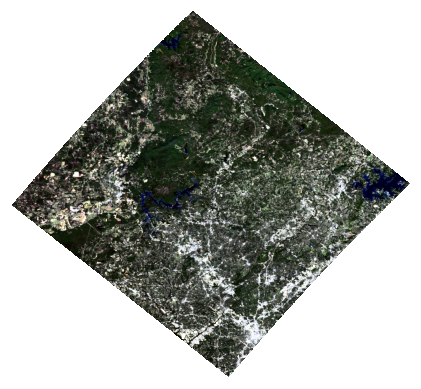

In [85]:
# L2ARFLのRGB画像を表示する
fig, ax = plt.subplots()
ax.imshow(l2a_rgb)
ax.axis("off")
plt.show()

In [8]:
# L2BCH4PLMデータ (Cloud Optimized GeoTIFF形式) を読み込む
with rasterio.open(l2b_path) as src:
    # オルソ補正のための変換パラメータを計算する
    transform, width, height = calculate_default_transform(
        src.crs, src.crs, src.width, src.height, *src.bounds
    )

    # オルソ補正されたデータを格納するためのメタデータを更新
    kwargs = src.meta.copy()
    kwargs.update({
        "crs": src.crs,
        "transform": transform,
        "width": width,
        "height": height
    })

    # オルソ補正してデータを保存
    with rasterio.open(l2b_path.replace(".tif", "_orthorectified.tif"), "w", **kwargs) as dst:
        for i in range(1, src.count + 1):
            reproject(
                source=rasterio.band(src, i),
                destination=rasterio.band(dst, i),
                src_transform=src.transform,
                src_crs=src.crs,
                dst_transform=transform,
                dst_crs=src.crs,
                resampling=Resampling.nearest  # 最近傍補間
            )

In [9]:
# オルソ補正されたデータを読み込む
l2b_orthorectified_path = l2b_path.replace(".tif", "_orthorectified.tif")
with rasterio.open(l2b_orthorectified_path) as src:


SyntaxError: incomplete input (4124146225.py, line 3)

# 位置合わせ_old
位置合わせを行う

In [30]:
import cartopy.crs as ccrs
import numpy as np
import pyproj
from netCDF4 import Dataset

In [33]:
import os
import earthaccess
import netCDF4 as nc
from osgeo import gdal
import numpy as np
import xarray as xr
import hvplot.xarray
import holoviews as hv
import sys
sys.path.append('../modules/')
from emit_tools import emit_xarray

In [31]:
l2a_path = "../../data/methane_plume/EMIT_L2A_RFL_001_20241020T170504_2429411_003.nc"
l2b_path = "../../data/methane_plume/EMIT_L2B_CH4PLM_001_20241020T170504_003677.tif"

In [32]:
# read in a dataset using emit_xarray function
l2a_ds = emit_xarray(l2a_path, ortho=True)
l2a_ds

<xarray.Dataset> Size: 5GB
Dimensions:           (latitude: 1999, longitude: 2173, wavelengths: 285)
Coordinates:
  * wavelengths       (wavelengths) float32 1kB 381.0 388.4 ... 2.493e+03
    fwhm              (wavelengths) float32 1kB ...
    good_wavelengths  (wavelengths) float32 1kB ...
  * latitude          (latitude) float64 16kB 34.71 34.71 34.71 ... 33.63 33.63
  * longitude         (longitude) float64 17kB -85.11 -85.11 ... -83.93 -83.93
    elev              (latitude, longitude) float32 17MB -9.999e+03 ... -9.99...
    spatial_ref       int64 8B 0
Data variables:
    reflectance       (latitude, longitude, wavelengths) float32 5GB -9.999e+...
Attributes: (12/40)
    ncei_template_version:             NCEI_NetCDF_Swath_Template_v2.0
    summary:                           The Earth Surface Mineral Dust Source ...
    keywords:                          Imaging Spectroscopy, minerals, EMIT, ...
    Conventions:                       CF-1.63
    sensor:                            EMIT (Earth Surface Mineral Dust Sourc...
    instrument:                        EMIT
    ...                                ...
    spatial_ref:                       GEOGCS["WGS 84",DATUM["WGS_1984",SPHER...
    geotransform:                      [-8.51101770e+01  5.42232520e-04 -0.00...
    day_night_flag:                    Day
    title:                             EMIT L2A Estimated Surface Reflectance...
    granule_id:                        EMIT_L2A_RFL_001_20241020T170504_24294...
    Orthorectified:                    True

In [35]:
# 欠損値処理をする
l2a_ds.reflectance.data[l2a_ds.reflectance.data == -9999] = np.nan

# red bandを可視化
l2a_ds.sel(wavelengths=850,method="nearest").hvplot.image(cmap="viridis", aspect="equal", frame_width=500, rasterize=True)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


BokehModel(combine_events=True, render_bundle={'docs_json': {'8fd4743f-f8d0-401d-afd0-a964399a67eb': {'version…

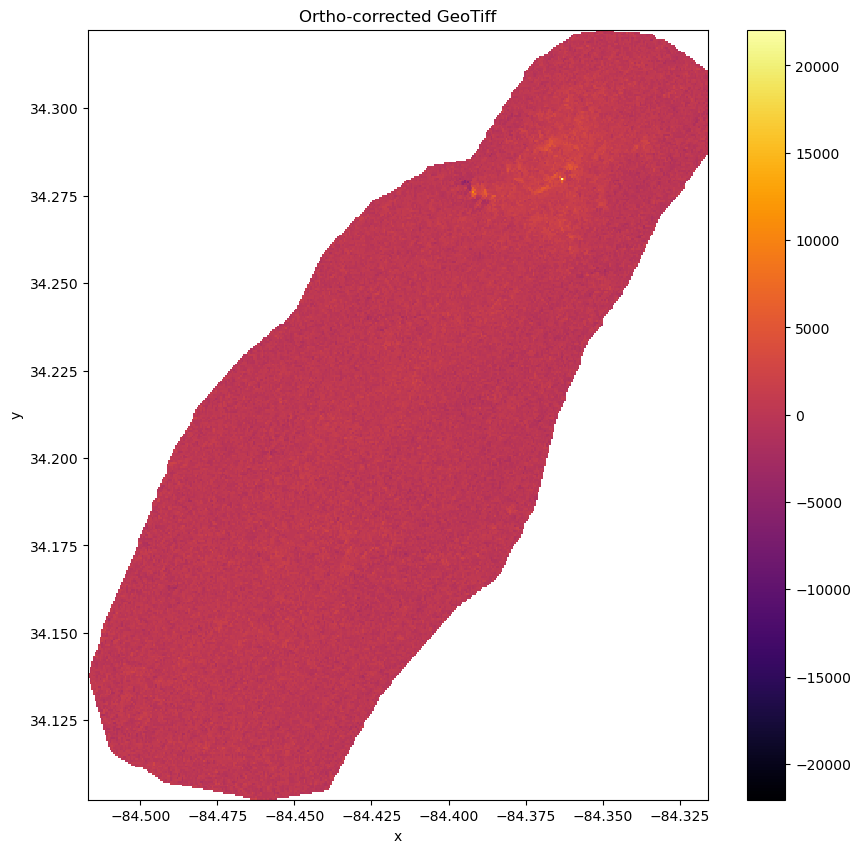

In [44]:
import rasterio
import rioxarray as rxr
import matplotlib.pyplot as plt
from rasterio.plot import show
from rasterio.warp import calculate_default_transform, reproject, Resampling

with rasterio.open(l2b_path) as src:
    transform, width, height = calculate_default_transform(
        src.crs, src.crs, src.width, src.height, *src.bounds
    )
    kwargs = src.meta.copy()
    kwargs.update({
        "crs": src.crs,
        "transform": transform,
        "width": width,
        "height": height
    })
    ortho_data = rasterio.open("ortho_corrected.tif", "w", **kwargs)

    for i in range(1, src.count + 1):
        reproject(
            source=rasterio.band(src, i),
            destination=rasterio.band(ortho_data, i),
            src_transform=src.transform,
            src_crs=src.crs,
            dst_transform=transform,
            dst_crs=src.crs,
            resampling=Resampling.nearest
        )

    ortho_data.close()

ortho_corrected = rxr.open_rasterio("ortho_corrected.tif", masked=True)

fig, ax = plt.subplots(figsize=(10, 10))
ortho_corrected.plot(ax=ax, cmap="plasma")
plt.title("Ortho-corrected GeoTiff")
plt.show()

In [46]:
ortho_corrected.data

array([[[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]], dtype=float32)

In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt

def visualize_geotiff(geotiff_path):
    """GeoTIFFを可視化する関数"""
    with rasterio.open(geotiff_path) as src:
        # データの読み込み
        data = src.read()

        # 可視化
        plt.imshow(data, cmap="gray")


## old

In [13]:
# .ncファイルを読み込む
l2a_data = xr.open_dataset(l2a_path)

In [36]:
print(l2a_data)

<xarray.Dataset> Size: 2GB
Dimensions:      (downtrack: 1280, crosstrack: 1242, bands: 285)
Dimensions without coordinates: downtrack, crosstrack, bands
Data variables:
    reflectance  (downtrack, crosstrack, bands) float32 2GB ...
Attributes: (12/38)
    ncei_template_version:             NCEI_NetCDF_Swath_Template_v2.0
    summary:                           The Earth Surface Mineral Dust Source ...
    keywords:                          Imaging Spectroscopy, minerals, EMIT, ...
    Conventions:                       CF-1.63
    sensor:                            EMIT (Earth Surface Mineral Dust Sourc...
    instrument:                        EMIT
    ...                                ...
    southernmost_latitude:             33.62839491966192
    spatialResolution:                 0.000542232520256367
    spatial_ref:                       GEOGCS["WGS 84",DATUM["WGS_1984",SPHER...
    geotransform:                      [-8.51101770e+01  5.42232520e-04 -0.00...
    day_night_flag: 

In [113]:
l2a_data["reflectance"]

<xarray.DataArray 'reflectance' (downtrack: 1280, crosstrack: 1242, bands: 285)> Size: 2GB
array([[[0.009641, 0.009352, ..., 0.013145, 0.014189],
        [0.012101, 0.011999, ..., 0.020853, 0.020403],
        ...,
        [0.016073, 0.015584, ..., 0.037503, 0.033165],
        [0.019993, 0.019088, ..., 0.02755 , 0.023064]],

       [[0.010778, 0.010671, ..., 0.022752, 0.022363],
        [0.011858, 0.011583, ..., 0.017464, 0.017205],
        ...,
        [0.014475, 0.014082, ..., 0.018385, 0.015416],
        [0.018366, 0.017813, ..., 0.020948, 0.021095]],

       ...,

       [[0.021052, 0.019998, ..., 0.094361, 0.088456],
        [0.013917, 0.014241, ..., 0.036458, 0.035112],
        ...,
        [0.013595, 0.01331 , ..., 0.029021, 0.025979],
        [0.018012, 0.017064, ..., 0.019341, 0.016678]],

       [[0.012562, 0.012785, ..., 0.029252, 0.026842],
        [0.012875, 0.013132, ..., 0.032872, 0.032032],
        ...,
        [0.014378, 0.014276, ..., 0.03358 , 0.030445],
        [0.017064, 0.016272, ..., 0.01334 , 0.012717]]], dtype=float32)
Dimensions without coordinates: downtrack, crosstrack, bands
Attributes:
    long_name:  Surface Reflectance
    units:      unitless

In [38]:
print(l2a_data.attrs.keys())

dict_keys(['ncei_template_version', 'summary', 'keywords', 'Conventions', 'sensor', 'instrument', 'platform', 'institution', 'license', 'naming_authority', 'date_created', 'keywords_vocabulary', 'stdname_vocabulary', 'creator_name', 'creator_url', 'project', 'project_url', 'publisher_name', 'publisher_url', 'publisher_email', 'identifier_product_doi_authority', 'flight_line', 'time_coverage_start', 'time_coverage_end', 'software_build_version', 'software_delivery_version', 'product_version', 'history', 'crosstrack_orientation', 'easternmost_longitude', 'northernmost_latitude', 'westernmost_longitude', 'southernmost_latitude', 'spatialResolution', 'spatial_ref', 'geotransform', 'day_night_flag', 'title'])


In [41]:
projection = ccrs.PlateCarree() # 正距円筒図法
lon_min = l2a_data.attrs["westernmost_longitude"]
lon_max = l2a_data.attrs["easternmost_longitude"]
lat_min = l2a_data.attrs["southernmost_latitude"]
lat_max = l2a_data.attrs["northernmost_latitude"]
geotransform = l2a_data.attrs["geotransform"]
spatial_ref = l2a_data.attrs["spatial_ref"]

In [117]:
print(spatial_ref)

GEOGCS["WGS 84",DATUM["WGS_1984",SPHEROID["WGS 84",6378137,298.257223563,AUTHORITY["EPSG","7030"]],AUTHORITY["EPSG","6326"]],PRIMEM["Greenwich",0,AUTHORITY["EPSG","8901"]],UNIT["degree",0.0174532925199433,AUTHORITY["EPSG","9122"]],AXIS["Latitude",NORTH],AXIS["Longitude",EAST],AUTHORITY["EPSG","4326"]]


In [114]:
# 回転角
rotation_angle = np.degrees(np.arctan2(-geotransform[4], geotransform[1]))

# CRSの定義
try:
    crs = pyproj.CRS.from_wkt(spatial_ref)
    print(crs)
    # CRSオブジェクトの情報にアクセスする例
    print(f"Name: {crs.name}")
    print(f"EPSG code: {crs.to_epsg()}") # EPSGコードが存在する場合
    print(f"WKT: {crs.to_wkt()}")
    if crs.to_epsg() is not None:
        transform = ccrs.epsg(crs.to_epsg()) # EPSGコードからcartopyのCRSを作成
    else:
        print("EPSGコードが取得できません。PlateCarreeを仮に使用します。")
        transform = ccrs.PlateCarree() # EPSGが取得できない場合はPlateCarreeで代用。ただし、厳密には正しくない可能性あり
except pyproj.exceptions.CRSError as e:
    print(f"WKT文字列の解析に失敗しました: {e}")
    transform = ccrs.PlateCarree() # WKT解析に失敗した場合もPlateCarreeで代用
except Exception as e: # その他の例外もキャッチ
    print(f"予期せぬエラーが発生しました: {e}")
    transform = ccrs.PlateCarree()

GEOGCS["WGS 84",DATUM["WGS_1984",SPHEROID["WGS 84",6378137,298.257223563,AUTHORITY["EPSG","7030"]],AUTHORITY["EPSG","6326"]],PRIMEM["Greenwich",0,AUTHORITY["EPSG","8901"]],UNIT["degree",0.0174532925199433,AUTHORITY["EPSG","9122"]],AXIS["Latitude",NORTH],AXIS["Longitude",EAST],AUTHORITY["EPSG","4326"]]
Name: WGS 84
EPSG code: 4326
WKT: GEOGCRS["WGS 84",DATUM["World Geodetic System 1984",ELLIPSOID["WGS 84",6378137,298.257223563,LENGTHUNIT["metre",1]]],PRIMEM["Greenwich",0,ANGLEUNIT["degree",0.0174532925199433]],CS[ellipsoidal,2],AXIS["geodetic latitude (Lat)",north,ORDER[1],ANGLEUNIT["degree",0.0174532925199433]],AXIS["geodetic longitude (Lon)",east,ORDER[2],ANGLEUNIT["degree",0.0174532925199433]],ID["EPSG",4326]]
予期せぬエラーが発生しました: EPSG code does not define a projection


In [92]:
# 図を作成
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, projection=projection)

# データをプロット
im = l2a_data["reflectance"].plot(ax=ax, transform=crs)

# 地図の範囲を設定
ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=projection)

# 回転処理
ax.rotate_axis(rotation_angle, origin=( (lon_min + lon_max)/2, (lat_min + lat_max)/2 ))

# 海岸線などを追加
ax.coastlines()
ax.gridlines(draw_labels=True)

# タイトルを追加
plt.title("Reflectance")

# カラーバーを追加
plt.colorbar(im, ax=ax, orientation="vertical")

# 表示
plt.show()

AttributeError: 'GeoAxes' object has no attribute 'rotate_axis'

Error in callback <function _draw_all_if_interactive at 0x150f5f6d0> (for post_execute), with arguments args (),kwargs {}:


TypeError: unsupported operand type(s) for +: 'CompositeGenericTransform' and 'CRS'

TypeError: unsupported operand type(s) for +: 'CompositeGenericTransform' and 'CRS'

<Figure size 1000x600 with 1 Axes>

EPSG code: 4326
予期せぬエラーが発生しました: EPSG code does not define a projection


TypeError: Axes.hist() got multiple values for argument 'x'

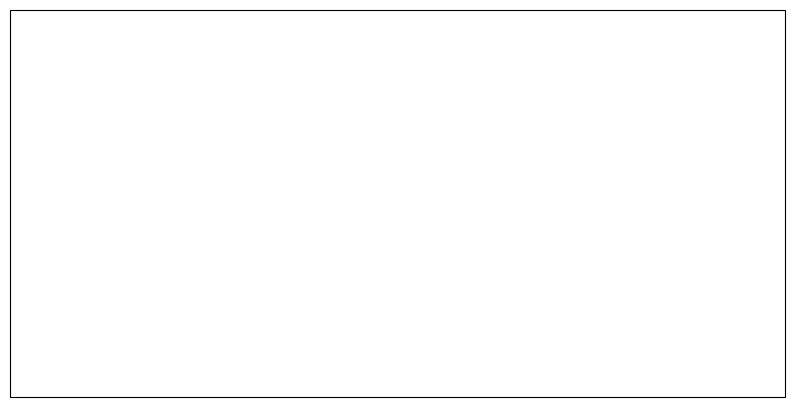

In [115]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import pyproj

# .ncファイルを読み込む
l2a_data = xr.open_dataset(l2a_path)

projection = ccrs.PlateCarree()
lon_min = l2a_data.attrs["westernmost_longitude"]
lon_max = l2a_data.attrs["easternmost_longitude"]
lat_min = l2a_data.attrs["southernmost_latitude"]
lat_max = l2a_data.attrs["northernmost_latitude"]
geotransform = l2a_data.attrs["geotransform"]
spatial_ref = l2a_data.attrs["spatial_ref"]

# CRSの定義とtransformの作成
try:
    crs = pyproj.CRS.from_wkt(spatial_ref)
    print(f"EPSG code: {crs.to_epsg()}")
    if crs.to_epsg() is not None:
        transform = ccrs.epsg(crs.to_epsg())
    else:
        print("EPSGコードが取得できません。PlateCarreeを仮に使用します。")
        transform = ccrs.PlateCarree()
except pyproj.exceptions.CRSError as e:
    print(f"WKT文字列の解析に失敗しました: {e}")
    transform = ccrs.PlateCarree()
except Exception as e:
    print(f"予期せぬエラーが発生しました: {e}")
    transform = ccrs.PlateCarree()

# 図を作成
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, projection=projection)

# データをプロット
im = l2a_data["reflectance"].plot(ax=ax, transform=transform, x="lon", y="lat") # transformとx, yを指定

# 地図の範囲を設定
ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=projection)

# 海岸線などを追加
ax.coastlines()
ax.gridlines(draw_labels=True)

# タイトルを追加
plt.title("Reflectance")

# カラーバーを追加
plt.colorbar(im) # ax引数は不要

# 表示
plt.show()

In [ ]:
# .ncファイルを読み込み
l2a_path = "../../data/methane_plume/EMIT_L2A_RFL_001_20241020T170504_2429411_003.nc"
l2a_nc_data = Dataset(l2a_path, "r")
print(l2a_nc_data)

<class 'netCDF4.Dataset'>
root group (NETCDF4 data model, file format HDF5):
    ncei_template_version: NCEI_NetCDF_Swath_Template_v2.0
    summary: The Earth Surface Mineral Dust Source Investigation (EMIT) is an Earth Ventures-Instrument (EVI-4) Mission that maps the surface mineralogy of arid dust source regions via imaging spectroscopy in the visible and short-wave infrared (VSWIR). Installed on the International Space Station (ISS), the EMIT instrument is a Dyson imaging spectrometer that uses contiguous spectroscopic measurements from 410 to 2450 nm to resolve absoprtion features of iron oxides, clays, sulfates, carbonates, and other dust-forming minerals. During its one-year mission, EMIT will observe the sunlit Earth's dust source regions that occur within +/-52° latitude and produce maps of the source regions that can be used to improve forecasts of the role of mineral dust in the radiative forcing (warming or cooling) of the atmosphere.\n\nThis file contains L2A estimated sur

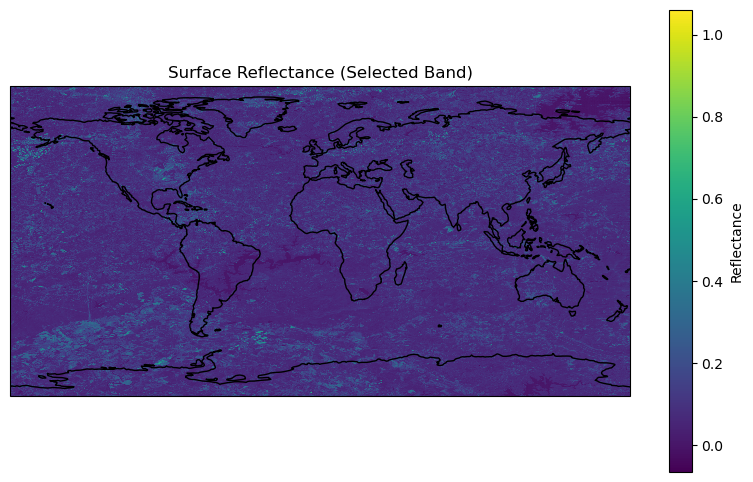

In [129]:
# 必要な変数の取得
reflectance = l2a_nc_data.variables["reflectance"][:]  # (downtrack, crosstrack, bands)
downtrack = reflectance.shape[0]
crosstrack = reflectance.shape[1]
bands = reflectance.shape[2]

# 適切なスペクトルバンドを選択 (例: 中央のバンド)
selected_band = reflectance[:, :, bands // 2]

# 緯度・経度情報の取得
# NetCDF ファイルに 'latitude' と 'longitude' があると仮定
latitude = np.linspace(-90, 90, downtrack)  # 仮の緯度
longitude = np.linspace(-180, 180, crosstrack)  # 仮の経度

# プロットの準備
crs = ccrs.PlateCarree()

fig, ax = plt.subplots(subplot_kw={"projection": crs}, figsize=(10, 6))
ax.coastlines()
ax.set_global()  # 全地球を表示

# Reflectance データのプロット
mesh = ax.pcolormesh(longitude, latitude, selected_band, transform=crs, cmap="viridis")

# カラーバーとタイトル
plt.colorbar(mesh, ax=ax, orientation="vertical", label="Reflectance")
plt.title("Surface Reflectance (Selected Band)")
plt.show()

# 位置合わせ

In [9]:
# setup
import earthaccess
import os
import warnings
import csv
from osgeo import gdal
import numpy as np
import math
import rasterio as rio
import xarray as xr
import holoviews as hv
import hvplot.xarray
import netCDF4 as nc
from dotenv import load_dotenv
import sys
sys.path.append('../modules/')
from emit_tools import emit_xarray

# This will ignore some warnings caused by holoviews
warnings.simplefilter('ignore')

In [10]:
# Log in to Earthdata
load_dotenv()
earthaccess.login(strategy="environment", persist=True)

In [14]:
# data paths of L2A and L2B
l2a_path = "../../data/methane_plume/EMIT_L2A_RFL_001_20241020T170504_2429411_003.nc"
l2b_path = "../../data/methane_plume/EMIT_L2B_CH4PLM_001_20241020T170504_003677.tif"

## 位置合わせ前のL2A

In [12]:
# open L2A data
l2a_ds_nc = nc.Dataset(l2a_path) # open as netCDF4 (to see the structure)
l2a_ds = xr.open_dataset(l2a_path) # open as xarray (extract only the root group)
l2a_wvl = xr.open_dataset(l2a_path,group='sensor_band_parameters') # sensors and parameters
l2a_loc = xr.open_dataset(l2a_path,group='location') # location
# Create coordinates and an index for the downtrack and crosstrack dimensions, then unpack the variables from the wvl and loc datasets and set them as coordinates for ds
l2a_ds = l2a_ds.assign_coords({'downtrack':(['downtrack'], l2a_ds.downtrack.data),'crosstrack':(['crosstrack'],l2a_ds.crosstrack.data), **l2a_wvl.variables, **l2a_loc.variables})
l2a_ds = l2a_ds.swap_dims({'bands':'wavelengths'})
l2a_ds

OSError: [Errno -51] NetCDF: Unknown file format: '../../data/methane_plume/EMIT_L2A_RFL_001_20241020T170504_2429411_003.nc'

In [5]:
l2a_ds['reflectance'].data[:,:,l2a_ds['good_wavelengths'].data==0] = np.nan

In [6]:
l2a_ds['reflectance'].sel(downtrack=660,crosstrack=370).hvplot.line(y='reflectance',x='wavelengths', color='black', frame_height=400, frame_width=600)

:Curve   [wavelengths]   (Surface Reflectance)

In [7]:
refl850 = l2a_ds.sel(wavelengths=850, method='nearest')
refl850.hvplot.image(cmap='viridis', aspect = 'equal', frame_width=720).opts(title=f"{refl850.wavelengths.values:.3f} {refl850.wavelengths.units}")

:Image   [crosstrack,downtrack]   (Surface Reflectance)

## オルソ補正後のL2A

In [6]:
l2a_ds_geo = emit_xarray(l2a_path, ortho=True)

OSError: Unable to synchronously open file (file signature not found)

In [9]:
non_ortho_fig = l2a_ds.sel(wavelengths=850, method='nearest').hvplot.image(cmap='Viridis', aspect = 'equal',frame_height=600).opts(
         title=f"Reflectance at {refl850.wavelengths.values:.3f} {refl850.wavelengths.units}")

In [10]:
l2a_ds_geo.reflectance.data[l2a_ds_geo.reflectance.data == -9999] = np.nan

In [ ]:
l2a_ds_geo.sel(wavelengths=850, method='nearest').hvplot.image(cmap='Viridis', geo=True, tiles='ESRI', alpha=0.8, frame_height=600).opts(
    title=f"Reflectance at {refl850.wavelengths.values:.3f} {refl850.wavelengths.units} (Orthorectified)")

:Overlay
   .WMTS.I  :WMTS   [Longitude,Latitude]
   .Image.I :Image   [longitude,latitude]   (Surface Reflectance)

In [12]:
ds_geo['reflectance'].data[:,:,ds_geo['good_wavelengths'].data==0] = np.nan

In [13]:
# 書き出す
ds_geo = ds_geo.transpose('wavelengths','latitude','longitude')
ds_geo.to_netcdf('../../data/geo_ds_out.nc')

ds = xr.open_dataset('../data/geo_ds_out.nc')

FileNotFoundError: [Errno 2] No such file or directory: '/Users/ishidaryoma/EMIT-Data-Resources/python/data/geo_ds_out.nc'

In [ ]:
l2a_geo = xr.open_dataset()

<xarray.Dataset> Size: 5GB
Dimensions:           (latitude: 1999, longitude: 2173, wavelengths: 285)
Coordinates:
  * wavelengths       (wavelengths) float32 1kB 381.0 388.4 ... 2.493e+03
    fwhm              (wavelengths) float32 1kB ...
    good_wavelengths  (wavelengths) float32 1kB 1.0 1.0 1.0 1.0 ... 1.0 1.0 1.0
  * latitude          (latitude) float64 16kB 34.71 34.71 34.71 ... 33.63 33.63
  * longitude         (longitude) float64 17kB -85.11 -85.11 ... -83.93 -83.93
    elev              (latitude, longitude) float32 17MB -9.999e+03 ... -9.99...
    spatial_ref       int64 8B 0
Data variables:
    reflectance       (wavelengths, latitude, longitude) float32 5GB nan ... nan
Attributes: (12/40)
    ncei_template_version:             NCEI_NetCDF_Swath_Template_v2.0
    summary:                           The Earth Surface Mineral Dust Source ...
    keywords:                          Imaging Spectroscopy, minerals, EMIT, ...
    Conventions:                       CF-1.63
    sensor:                            EMIT (Earth Surface Mineral Dust Sourc...
    instrument:                        EMIT
    ...                                ...
    spatial_ref:                       GEOGCS["WGS 84",DATUM["WGS_1984",SPHER...
    geotransform:                      [-8.51101770e+01  5.42232520e-04 -0.00...
    day_night_flag:                    Day
    title:                             EMIT L2A Estimated Surface Reflectance...
    granule_id:                        EMIT_L2A_RFL_001_20241020T170504_24294...
    Orthorectified:                    True

In [ ]:
# L2BCH4PLMデータ (Cloud Optimized GeoTIFF形式) を読み込む
with rasterio.open(l2b_path) as src:
    # オルソ補正のための変換パラメータを計算する
    transform, width, height = calculate_default_transform(
        src.crs, src.crs, src.width, src.height, *src.bounds
    )

    # オルソ補正されたデータを格納するためのメタデータを更新
    kwargs = src.meta.copy()
    kwargs.update({
        "crs": src.crs,
        "transform": transform,
        "width": width,
        "height": height
    })

    # オルソ補正してデータを保存
    with rasterio.open(l2b_path.replace(".tif", "_orthorectified.tif"), "w", **kwargs) as dst:
        for i in range(1, src.count + 1):
            reproject(
                source=rasterio.band(src, i),
                destination=rasterio.band(dst, i),
                src_transform=src.transform,
                src_crs=src.crs,
                dst_transform=transform,
                dst_crs=src.crs,
                resampling=Resampling.nearest  # 最近傍補間
            )

BoundingBox(left=-84.51697466984024, bottom=34.10230614236599, right=-84.31580640482512, top=34.322452545590075)


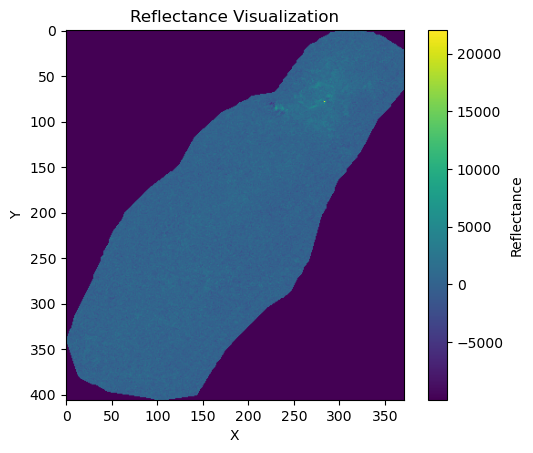

In [29]:
l2b_orthorectified_path = l2b_path.replace(".tif", "_orthorectified.tif")
with rasterio.open(l2b_orthorectified_path) as src:
    reflectance = src.read(1)
    bbox_l2b = src.bounds

print(bbox_l2b)


import matplotlib.pyplot as plt
plt.imshow(reflectance, cmap='viridis')
plt.colorbar(label='Reflectance')
plt.title('Reflectance Visualization')
plt.xlabel('X')
plt.ylabel('Y')
plt.show()

## L2Bの位置合わせ

In [24]:
reflectance.shape

(406, 371)

In [28]:
# バウンディングボックスを取得
geojson = gpd.read_file("../../data/methane_plume/EMIT_L2B_CH4PLM_001_20241020T170504_003677.json")
print(geojson.geometry)
bbox = tuple(list(geojson.total_bounds))
print("Bounding Box: ", bbox)

Skipping field DAAC Scene Numbers: unsupported OGR type: 5
Skipping field Scene FIDs: unsupported OGR type: 5
Skipping field DAAC Scene Names: unsupported OGR type: 5


0    POLYGON ((-84.34997 34.32245, -84.35973 34.321...
Name: geometry, dtype: geometry
Bounding Box:  (-84.5169747, 34.1017639, -84.3152642, 34.3224525)


In [32]:
import rasterio
from rasterio.windows import from_bounds

# L2Bのバウンディングボックスを取得
with rasterio.open(l2b_orthorectified_path) as l2b_src:
    bbox = l2b_src.bounds
    print(f"L2B Bounding Box: {bbox}")

# L2Aオルソ補正後の画像を開く
with rasterio.open(l2b_path.replace(".tif", "_orthorectified.tif")) as l2a_src:
    # bboxに基づいてウィンドウを作成
    window = from_bounds(bbox.left, bbox.bottom, bbox.right, bbox.top, transform=l2a_src.transform)

    # ウィンドウに基づいてデータを読み込む
    cropped_data = l2a_src.read(window=window)


    # 新しいメタデータを作成
    kwargs = l2a_src.meta.copy()
    kwargs.update({
        'window': window,
        'height': window.height,
        'width': window.width
    })

    # 切り取ったデータを保存
    cropped_l2a_path = l2a_path.replace(".tif", "_cropped.tif")
    with rasterio.open(cropped_l2a_path, 'w', **kwargs) as dst:
        dst.write(cropped_data)

L2B Bounding Box: BoundingBox(left=-84.51697466984024, bottom=34.10230614236599, right=-84.31580640482512, top=34.322452545590075)


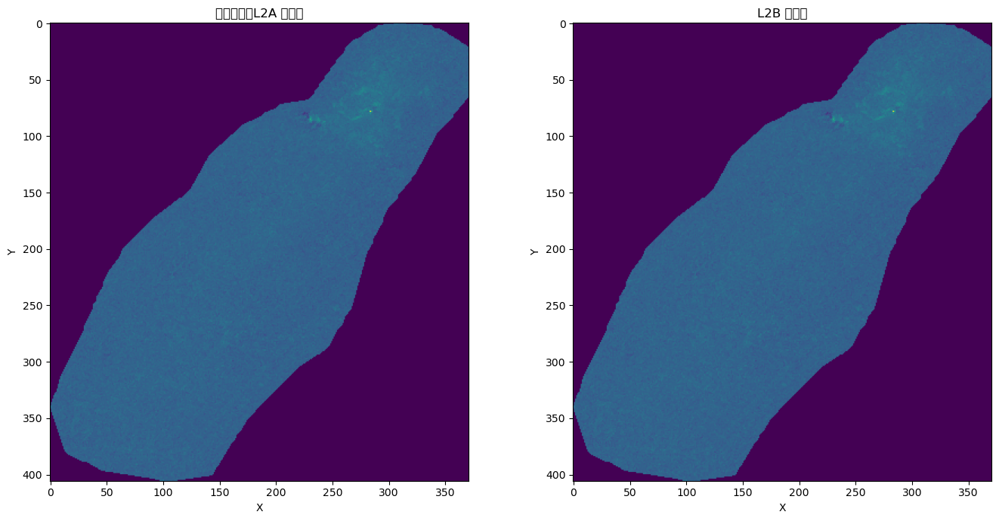

In [33]:
import rasterio
import matplotlib.pyplot as plt

# 切り取ったL2Aデータを読み込む
with rasterio.open(cropped_l2a_path) as l2a_src:
    l2a_data = l2a_src.read(1)

# L2Bデータを読み込む
with rasterio.open(l2b_orthorectified_path) as l2b_src:
    l2b_data = l2b_src.read(1)

# 可視化
fig, axes = plt.subplots(1, 2, figsize=(14, 7))

axes[0].imshow(l2a_data, cmap='viridis')
axes[0].set_title('切り取ったL2A 反射率')
axes[0].set_xlabel('X')
axes[0].set_ylabel('Y')

axes[1].imshow(l2b_data, cmap='viridis')
axes[1].set_title('L2B 反射率')
axes[1].set_xlabel('X')
axes[1].set_ylabel('Y')

plt.tight_layout()
plt.show()

import rasterio
import matplotlib.pyplot as plt

# 切り取ったL2Aデータを読み込む
with rasterio.open(cropped_l2a_path) as l2a_src:
    l2a_data = l2a_src.read(1)

# L2Bデータを読み込む
with rasterio.open(l2b_orthorectified_path) as l2b_src:
    l2b_data = l2b_src.read(1)

# 可視化
fig, axes = plt.subplots(1, 2, figsize=(14, 7))

axes[0].imshow(l2a_data, cmap='viridis')
axes[0].set_title('切り取ったL2A 反射率')
axes[0].set_xlabel('X')
axes[0].set_ylabel('Y')

axes[1].imshow(l2b_data, cmap='viridis')
axes[1].set_title('L2B 反射率')
axes[1].set_xlabel('X')
axes[1].set_ylabel('Y')

plt.tight_layout()
plt.show()